# Lecture d'un compteur d'eau

Cette tâche se divisera ici en 2:
* détection de la lécture (um nombre)
* reconnaissance du texte (chaîne de chiffres)


# Résumé


La détection d'un nombre d'un compteur d'eau s'est fait en utilisant un modèle de détéction d'obejt: YOLOv5s. Le choix du modèle n'a pas suivi un critère spécifique. Son utilisation pour ce type de tâche est toutefois courrant dans la communauté.

Due aux contraintes de temps, entraîner un nouveau modèle ne se faisait envisageable.

Le dataset pour cette tâche est composé de:
* training: 80 images
* validation: 30 images
* test: 20 images

Ces images ont été obtenues d'après le dataset originale et ont due être toutes annottées. Pour ce fin, la plateforme **Roboflow** a été utilisé pour sa fonctionalité et support de la communauté.

Le modèle a eu une precision globale de ~80% (training et test) pour ce dataset et un nombre de 150 itérations.
Toutefois, la baisse confidence du modèle (le seuil utilisé a du été réglé pour 0.1 afin de pouvoir avoir des résultats visibles) pour détecter le nombre, montre clairement qu'un nombre plus important d'itération et/ou de dataset se fait nécessaire.

La reconnaissance du texte a eu une pérformance très baisse de 15% (3 images sur 20) et demande plus d'investigation sur les divers types de processement d'image et des méthodes spécifique pour reconnaître une chaîne de chiffres.

Pour cette partie d'OCR, on a divisé la tâche en 2 notebooks:
*  application directe d'OCR sur les images sans processement (dans ce notebook)
*  applicatoin directe d'OCR sur les images prè-processées (dans le notebook "OCR processement d'images")


In [1]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import shutil
import os
try:
  shutil.rmtree("/content/meter")
except:
  pass

try:
  shutil.rmtree("/content/datasets/")
except:
  pass  

os.mkdir("/content/meter")

In [ ]:
!unzip "/content/drive/MyDrive/meter/meters.v4i.yolov5pytorch.zip" -d /content/meter/

In [4]:
# !conda install pytorch torchvision cudatoolkit=11.3 -c pytorch

In [5]:
!git clone https://github.com/ultralytics/yolov5  
%cd yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 12447, done.
remote: Counting objects: 100% (66/66), done.
remote: Compressing objects: 100% (55/55), done.
remote: Total 12447 (delta 30), reused 37 (delta 11), pack-reused 12381
Receiving objects: 100% (12447/12447), 12.25 MiB | 20.71 MiB/s, done.
Resolving deltas: 100% (8574/8574), done.
/content/yolov5


<font color=003762>Install requirements:

In [6]:
%pip install -qr requirements.txt  

     |████████████████████████████████| 596 kB 5.3 MB/s 


<font color=003762>Import libraries:

In [7]:
# %cd yolov5
import torch
from yolov5 import utils
import torch
import utils
from IPython import display
from IPython.display import clear_output
from pathlib import Path
import yaml
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
%matplotlib inline
display = utils.notebook_init()

YOLOv5 🚀 v6.1-289-g526e650 Python-3.7.13 torch-1.11.0+cu113 CPU


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 38.5/107.7 GB disk)


Création des dossier pour les fichiers

In [8]:
from pathlib import Path
def create_data_directories(data_name):
    Path(f"../datasets/{data_name}/images/train").mkdir(parents=True, exist_ok=True)
    Path(f"../datasets/{data_name}/images/valid").mkdir(parents=True, exist_ok=True)
    Path(f"../datasets/{data_name}/images/test").mkdir(parents=True, exist_ok=True)
    Path(f"../datasets/{data_name}/labels/train").mkdir(parents=True, exist_ok=True)
    Path(f"../datasets/{data_name}/labels/valid").mkdir(parents=True, exist_ok=True)
    Path(f"../datasets/{data_name}/labels/test").mkdir(parents=True, exist_ok=True)

    
create_data_directories('meter')

In [9]:
!mv /content/meter/valid/labels/* /content/datasets/meter/labels/valid/
!mv /content/meter/train/labels/* /content/datasets/meter/labels/train/
!mv /content/meter/test/labels/* /content/datasets/meter/labels/test/

!mv /content/meter/valid/images/* /content/datasets/meter/images/valid/
!mv /content/meter/train/images/* /content/datasets/meter/images/train/
!mv /content/meter/test/images/* /content/datasets/meter/images/test/

In [10]:
!cp /content/drive/MyDrive/meter/meter_data.yaml /content/yolov5/data/

In [ ]:
!unzip "/content/drive/MyDrive/meter/yolov_v1.zip" -d /content/
!unzip "/content/drive/MyDrive/meter/yolov_v2_evolve2.zip" -d /content/yolov_v1_evolve2
!unzip "/content/drive/MyDrive/meter/yolov_v1_validation.zip" -d /content/yolov_v1_validation
!unzip "/content/drive/MyDrive/meter/yolov_v1_detect_test.zip" -d /content/yolov_v1_detect_test
!unzip "/content/drive/MyDrive/meter/yolov_v1_detect_test3_cropped.zip" -d /content/yolov_v1_detect_test_cropped

In [11]:
!cat data/meter_data.yaml
print ('---------------------------------------------')

train: ../datasets/meter/images/train
val: ../datasets/meter/images/valid
test: ../datasets/meter/images/test

nc: 1
names: ['meter']
---------------------------------------------


## <font color=2892A8>Training</font>

In [13]:
!python train.py --batch 32 --epochs 150 --data 'data/meter_data.yaml' --weights 'yolov5s6.pt' --project 'runs_meter' --name 'feature_extract' --cache --freeze 12
clear_output()

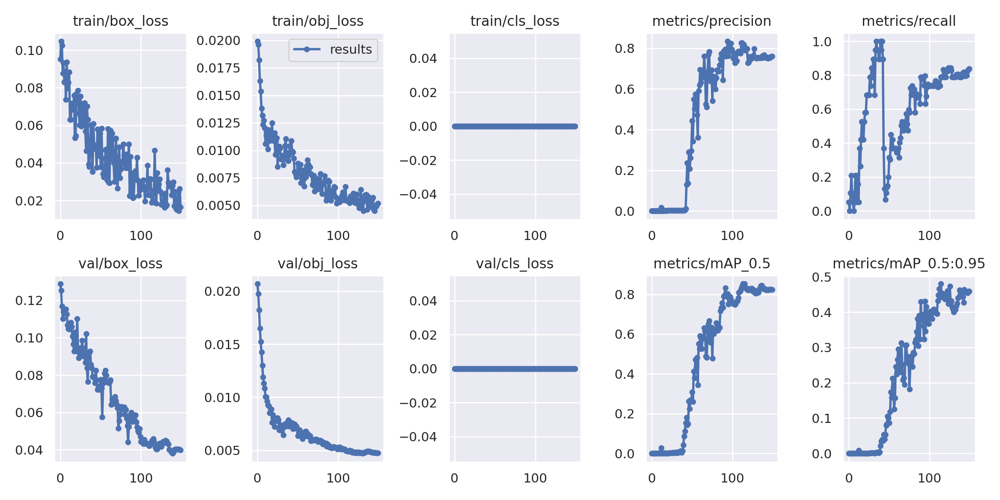

In [13]:
display.Image(f"/content/content/yolov5/runs_meter/feature_extract/results.png")

In [15]:
# !zip -r /content/yolov_v1  /content/yolov5/runs_meter/


# from google.colab import files
# files.download("/content/yolov_v1.zip")

In [16]:
# !python train.py --hyp '/content/yolov5/data/hyps/hyp.Objects365.yaml' --batch 16 --epochs 100 --data 'data/meter_data.yaml' --weights 'runs_meter/feature_extract/weights/best.pt' --project 'runs_meter' --name 'fine-tune_v1' --cache
# clear_output()

In [18]:
# !python train.py --batch 16 --epochs 100 --data 'data/meter_data.yaml' --weights '/content/content/yolov5/runs_meter/feature_extract/weights/best.pt' --project 'runs_meter' --name 'fine-tune_v2_evolve' --cache --evolve 4

In [19]:
# !zip -r /content/yolov_v2_evolve2  /content/yolov5/runs_meter/fine-tune_v2_evolve2

# Validation sur le TEST data

In [21]:
!python val.py --weights '/content/content/yolov5/runs_meter/feature_extract/weights/best.pt' --batch 64 --data 'data/meter_data.yaml' --task test --project 'runs_meter' --name 'validation_on_test_data' --augment
clear_output()

In [22]:
# !zip -r /content/yolov_v1_validation  /content/yolov5/runs_meter/validation_on_test_data

Precision - Recall pour le TEST dataset

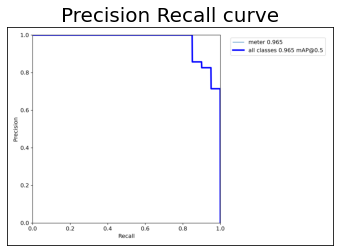

In [23]:
plt.plot(figsize=(30,30))
plt.title('Precision Recall curve', fontsize=20)
plt.tick_params(left = False, right = False , labelleft = False, labelbottom = False, bottom = False)
plt.imshow(mpimg.imread('/content/yolov_v1_validation/content/yolov5/runs_meter/validation_on_test_data/PR_curve.png'))


# Inférence sur le test dataset

obs: remarque pour la confiance de 0.1!

In [24]:
!python detect.py --weights '/content/content/yolov5/runs_meter/feature_extract/weights/best.pt'  --conf 0.1 --source '../datasets/meter/images/test' --project 'runs_meter' --name 'detect_test' --augment --line=3 --save-crop
clear_output()

In [25]:
# !zip -r /content/yolov_v1_detect_test3_cropped  /content/yolov5/runs_meter/detect_test2/crops/

Il y a un total de 20 images dans le dossier


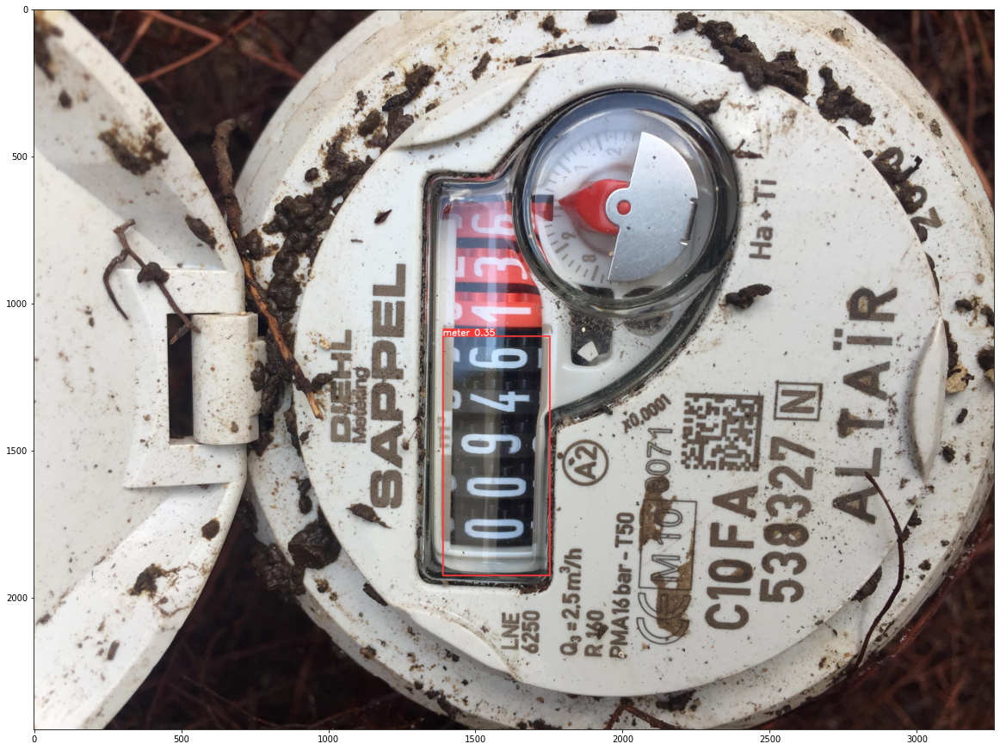

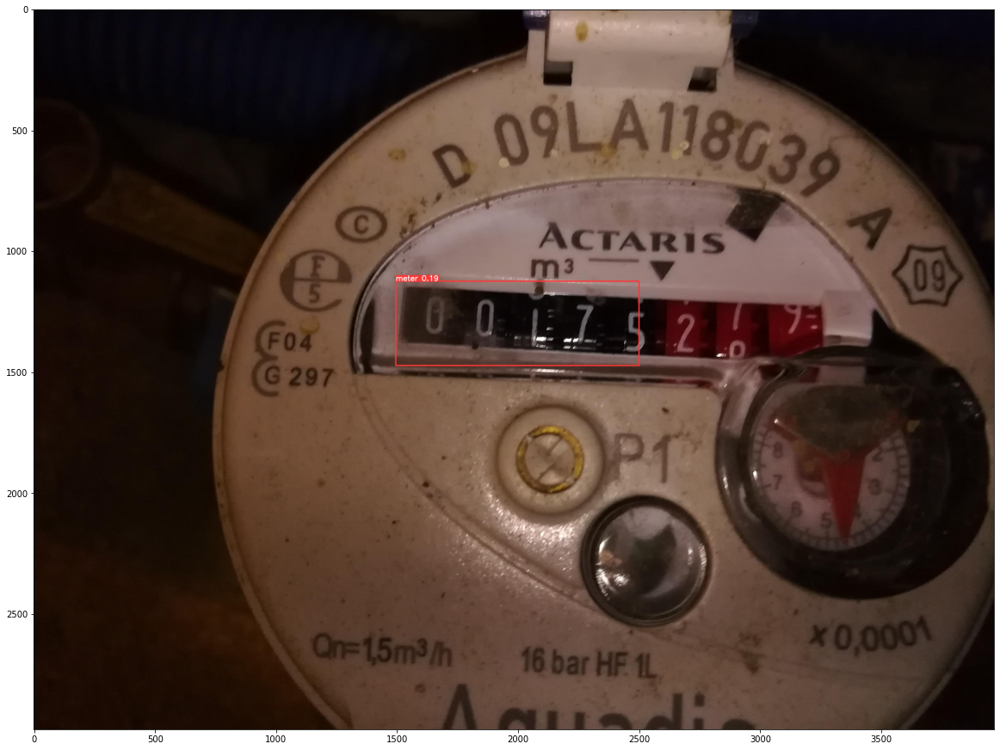

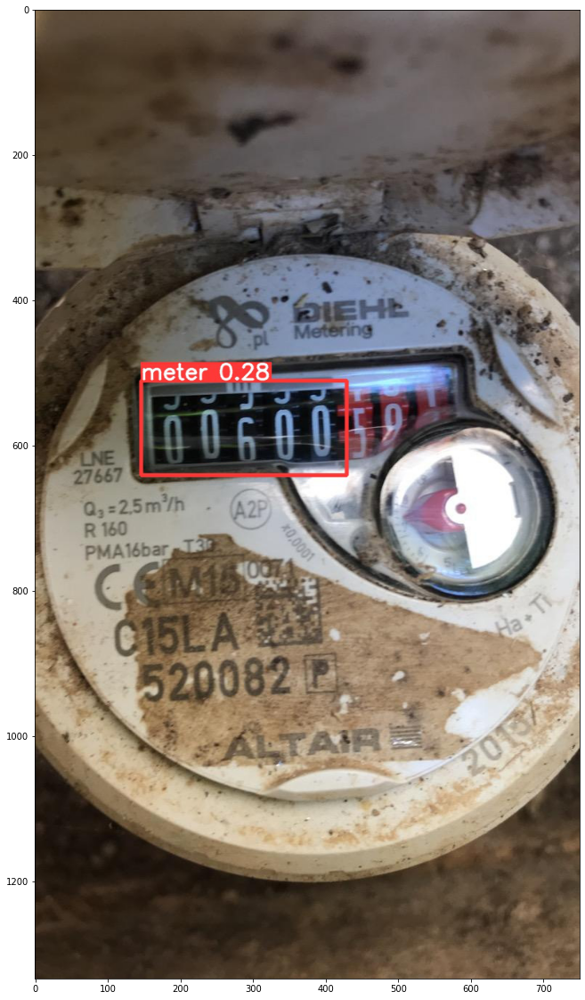

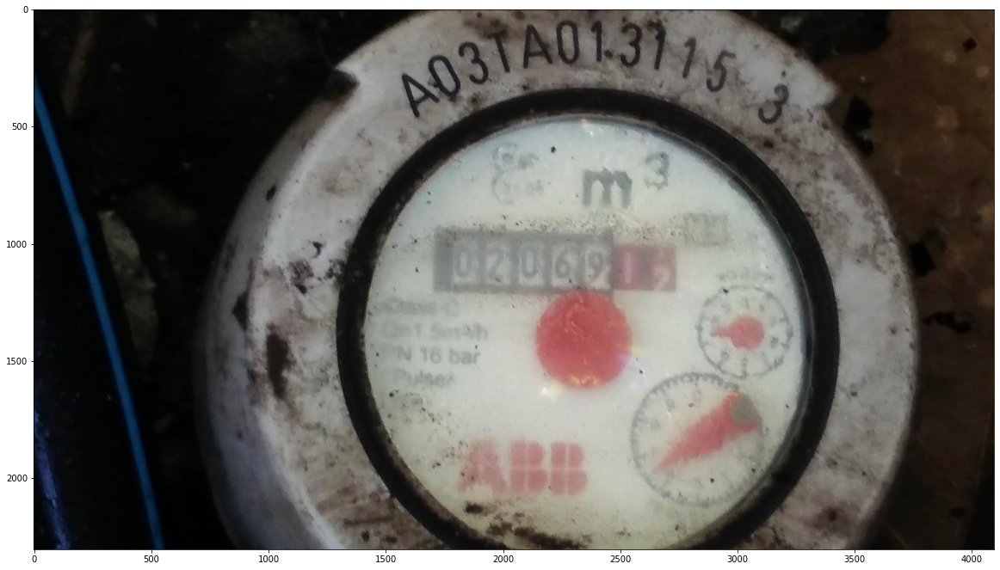

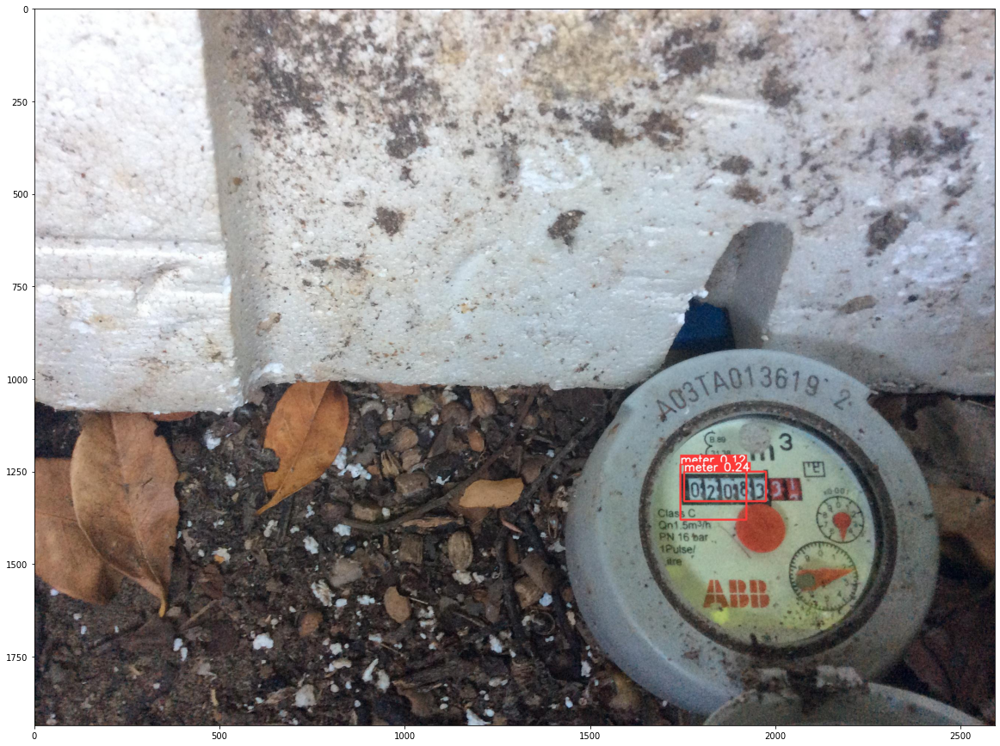

...

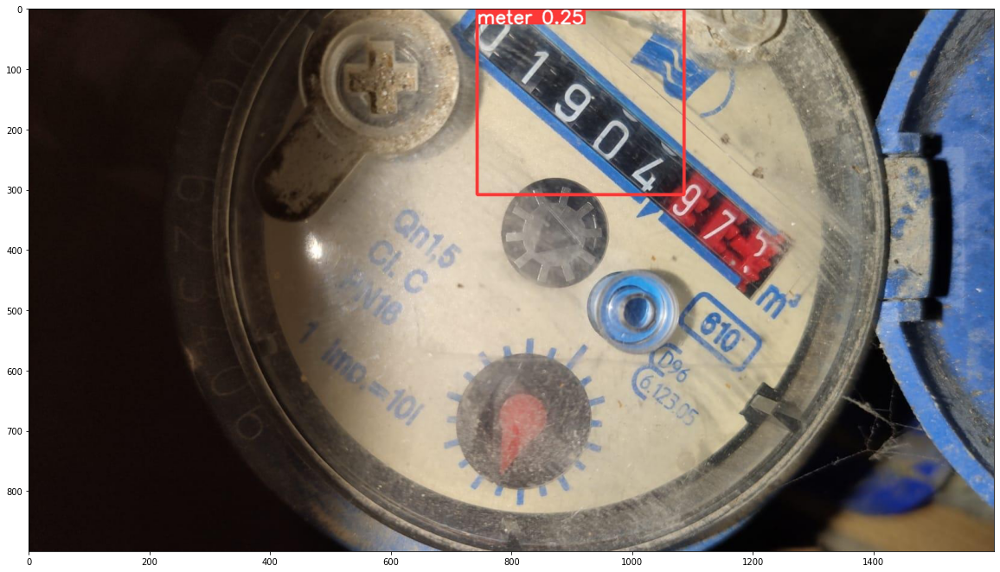

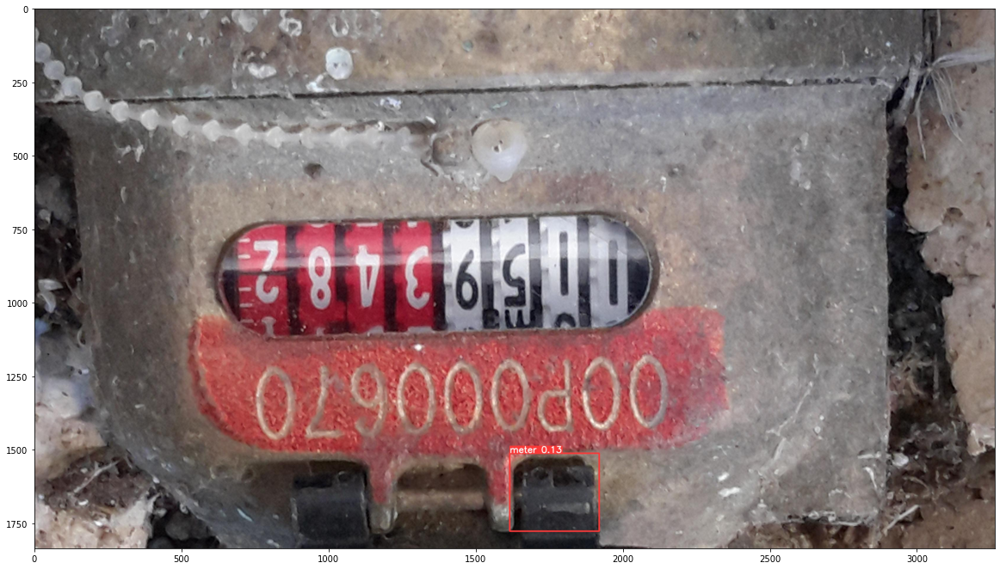

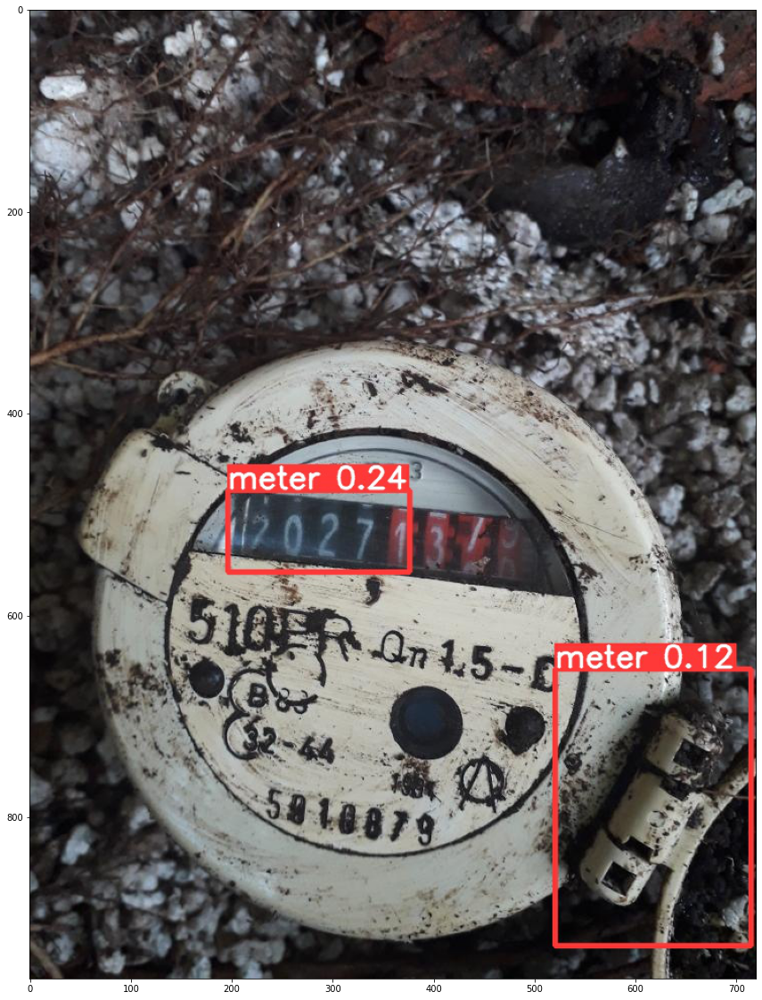

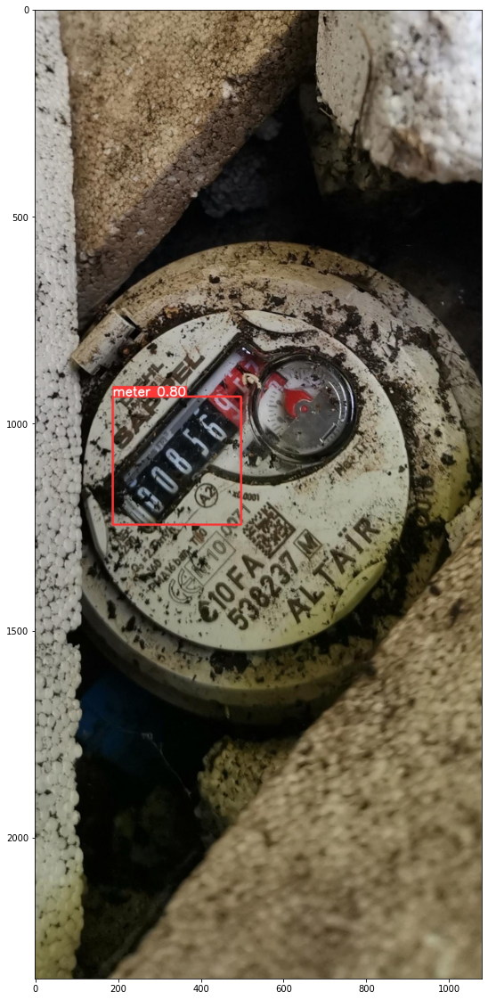

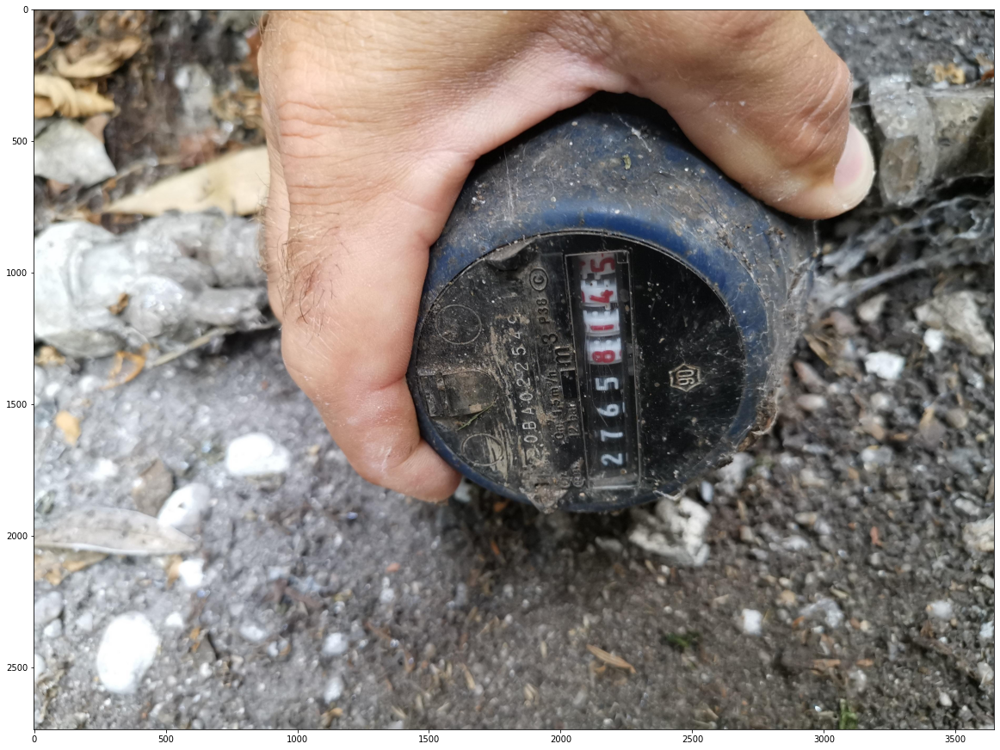

In [26]:
os.chdir("/content")
detect_path = r'/content/yolov_v1_detect_test/content/yolov5/runs_meter/detect_test3'
# detect_path = r'/yolov_v1_detect_test/content/yolov5/runs_meter/detect_test3'

images = []
for img_path in glob.glob(detect_path + '/*.jpg'):
# for img_path in os.listdir(detect_path):
    # print(img_path)
    images.append(mpimg.imread(img_path))
print(f"Il y a un total de {len(images)} images dans le dossier")
# plt.figure(figsize=(50,50))
columns = 4
for i, image in enumerate(images):
    plt.figure(figsize=(20,20))
    # plt.subplot((int(len(images) / columns + 1)), columns, i + 1)
    # plt.tick_params(left = False, right = False , labelleft = False, labelbottom = False, bottom = False)
    plt.imshow(image)
    plt.grid(False)

Nous pouvons noter que le modèle a bien détécte la plus part des bons chiffres du compteur à travers les 20 images.
Les confidences ne sont pas hautes et il y a certaines images qu'il se trompe d'object reconnu (comme la spécification du compteur)

# OCR sans processement d'image

# 1ère méthode OCR: PaddleOCR

Nous faisons un premier essai, en applicant l'OCR directement sur les images telles comme elles ont été sorties par le modèle de détection (sans distinction d'angle de rotation)

In [ ]:
os.chdir("/content/")
!pip install paddlepaddle-gpu
!pip install "paddleocr>=2.0.1"

In [31]:
import os
import glob
import random
import time
import cv2
import numpy as np
import subprocess
import sys
from PIL import Image
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
from paddleocr import PaddleOCR

/usr/local/lib/python3.7/dist-packages/scipy/fft/__init__.py:97: DeprecationWarning: The module numpy.dual is deprecated.  Instead of using dual, use the functions directly from numpy or scipy.
  from numpy.dual import register_func
/usr/local/lib/python3.7/dist-packages/scipy/special/orthogonal.py:81: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  from numpy import (exp, inf, pi, sqrt, floor, sin, cos, around, int,
/usr/local/lib/python3.7/dist-packages/scipy/sparse/sputils.py:17: DeprecationWarning: `np.typeDict` is a deprecated alias for `np.sc

In [32]:
font = cv2.FONT_HERSHEY_SIMPLEX
blue_color = (255,0,0)
white_color = (255,255,255)
black_color = (0,0,0)
green_color = (0,255,0)
yellow_color = (178, 247, 218)


In [50]:
import cv2
from google.colab.patches import cv2_imshow
# reference : https://learnopencv.com/automatic-license-plate-recognition-using-deep-learning

def crop(image, coord):
  # Cropping is done by -> image[y1:y2, x1:x2].
  cr_img = image[int(coord[1]):int(coord[3]), int(coord[0]):int(coord[2])]
  return cr_img


def test_img(input,croped, config_file, weights, out_path):

  input = croped
  img = cv2.imread(croped)
  # we have already our detected images
  h, w = img.shape[:2]
  if h > w:
    img = cv2.rotate(img.copy(), cv2.cv2.ROTATE_90_CLOCKWISE)
  # Extracting or cropping the license plate and applying the OCR.
  result = ocr.ocr(img,cls=False, det=False)
  # print("result : ", result)
  ocr_res = result[0][0]
  rec_conf = result[0][1]
  print("ocr result : ", ocr_res)
  if ocr_res == '':
    ocr_res = "None"

  height, width = img.shape[:2]
  # print("heigh and width : ", height, width)
  org = tuple((0,height))
  cv2.rectangle(img, (int(0), int(0)), (width, height), blue_color, 2)
  cv2.rectangle(img, (0,0), (0,0), blue_color,-1)
  cv2.putText(img, ocr_res, org, font, 2, blue_color,3)
  # Writing output image.

  file_name = os.path.join(out_path, 'out_' + input.split('/')[-1])
  cv2.imwrite(file_name, img)
  return img


ocr = PaddleOCR(lang='en',rec_algorithm='SVTR_LCNet')


[2022/07/08 18:25:25] ppocr DEBUG: Namespace(alpha=1.0, benchmark=False, beta=1.0, cls_batch_num=6, cls_image_shape='3, 48, 192', cls_model_dir='/root/.paddleocr/whl/cls/ch_ppocr_mobile_v2.0_cls_infer', cls_thresh=0.9, cpu_threads=10, crop_res_save_dir='./output', det=True, det_algorithm='DB', det_db_box_thresh=0.6, det_db_score_mode='fast', det_db_thresh=0.3, det_db_unclip_ratio=1.5, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_east_score_thresh=0.8, det_fce_box_type='poly', det_limit_side_len=960, det_limit_type='max', det_model_dir='/root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer', det_pse_box_thresh=0.85, det_pse_box_type='quad', det_pse_min_area=16, det_pse_scale=1, det_pse_thresh=0, det_sast_nms_thresh=0.2, det_sast_polygon=False, det_sast_score_thresh=0.5, draw_img_save_dir='./inference_results', drop_score=0.5, e2e_algorithm='PGNet', e2e_char_dict_path='./ppocr/utils/ic15_dict.txt', e2e_limit_side_len=768, e2e_limit_type='max', e2e_model_dir=None, e2e_pgnet_mode='f

Appellons OCR pour toutes les objets détectés:

ocr result :  E


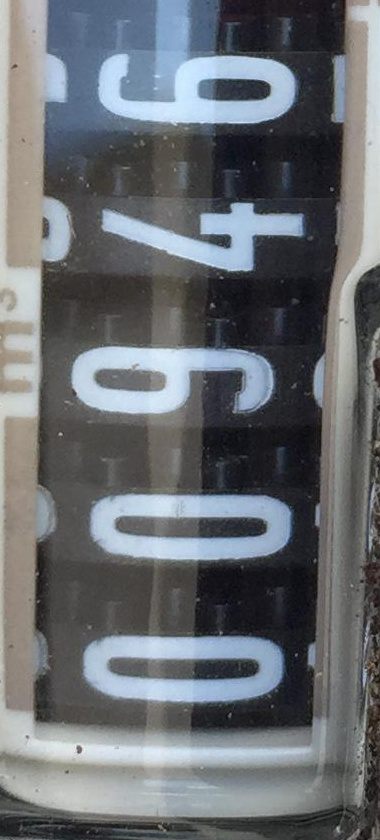

ocr result :  DOS


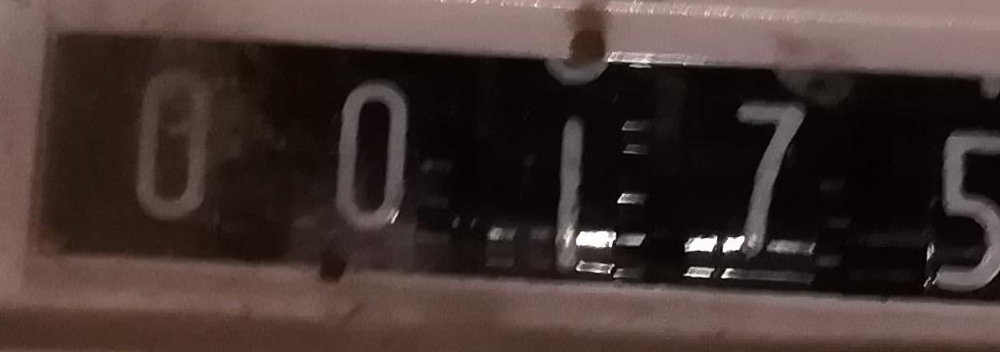

ocr result :  Gii


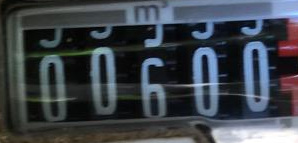

ocr result :  20


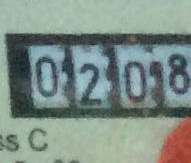

ocr result :  E


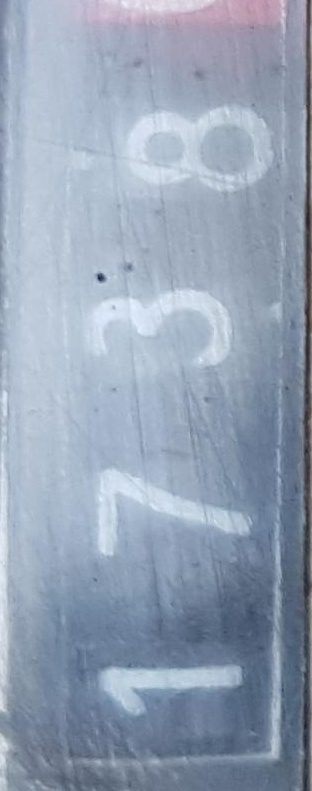

ocr result :  0208


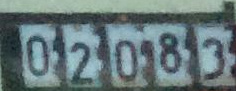

ocr result :  219312


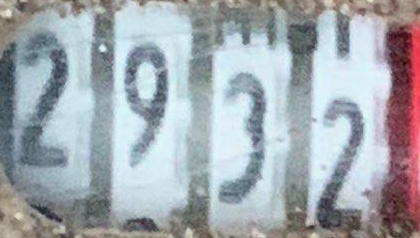

ocr result :  1105


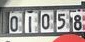

ocr result :  6061


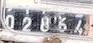

ocr result :  0203


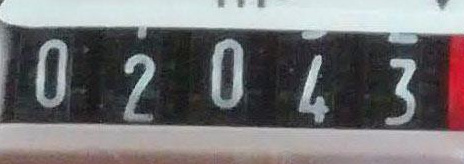

ocr result :  E


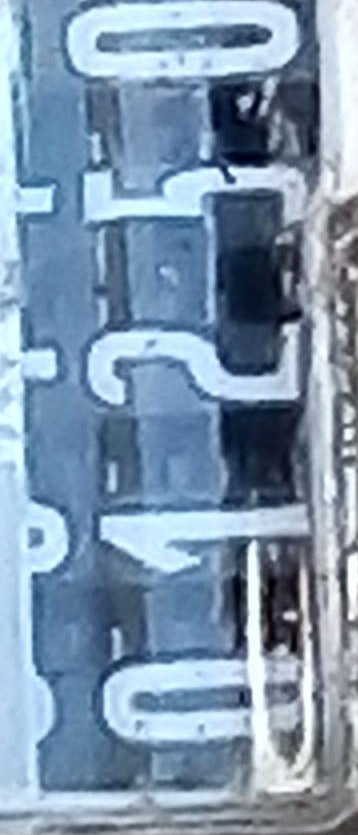

ocr result :  


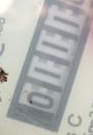

ocr result :  E


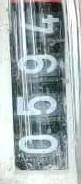

ocr result :  


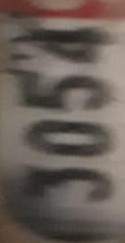

ocr result :  E


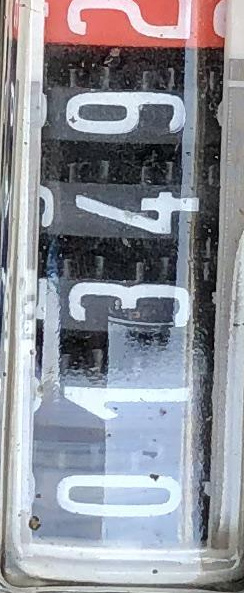

ocr result :  


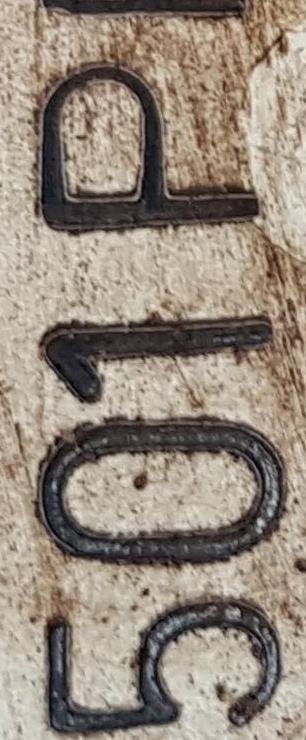

ocr result :  RTOE


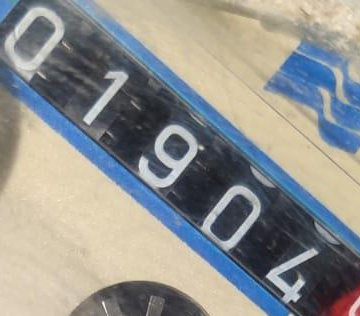

ocr result :  E


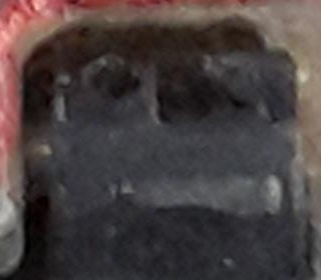

ocr result :  


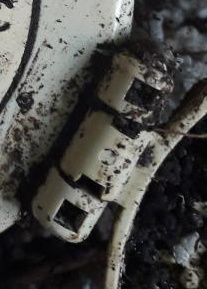

ocr result :  


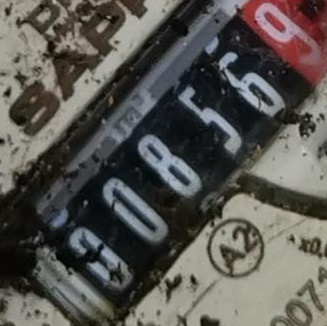

ocr result :  120271


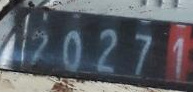

In [49]:
# croped img
img_dir= "/content/yolov_v1_detect_test_cropped/content/yolov5/runs_meter/detect_test2/crops/meter/abokgn_jpg.rf.838ab0a80b444fb0b436d02f72bee4f0.jpg"
cropped_dir = "/content/yolov_v1_detect_test_cropped/content/yolov5/runs_meter/detect_test2/crops/meter/"
# img_dir = "/content/datasets/meter/images/test/abokgn_jpg.rf.838ab0a80b444fb0b436d02f72bee4f0.jpg"

# test_img(None,img_dir, None, None, "/content/")

for each in os.listdir(cropped_dir):
  # print(each)
  img = cv2.imread(os.path.join(cropped_dir,each))
  
  _ = test_img(None, os.path.join(cropped_dir,each) ,None,None,"/content/")
  cv2_imshow(img)

C'est évidént que la rotation de l'image joue un rôle important pour l'OCR.

Faison un deuxième essai en faisant juste une rotation d'image (il ne s'agit pas d'une transformation) DANS LES CAS où l'hauteur est plus grande que la largeur (un fort indice de que le chiffre est rotationné).

ocr result :  (00946


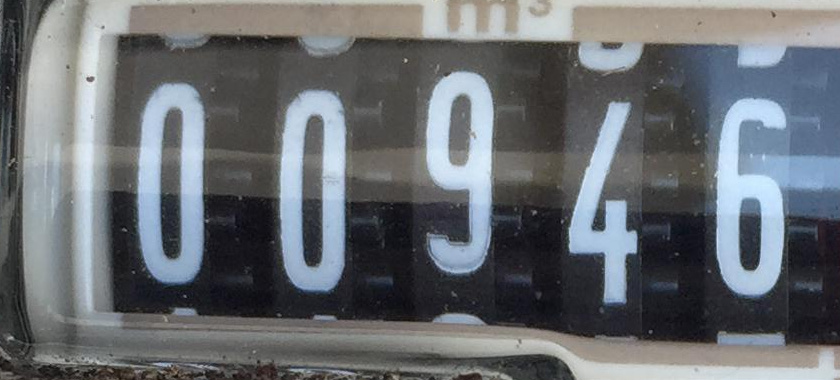

ocr result :  DOS


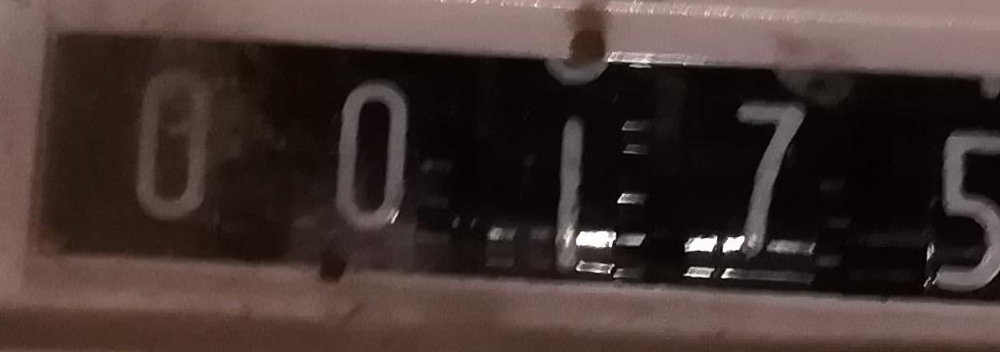

ocr result :  Gii


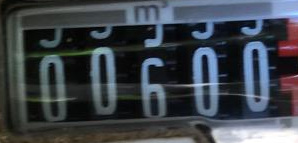

ocr result :  20


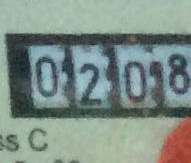

ocr result :  1738


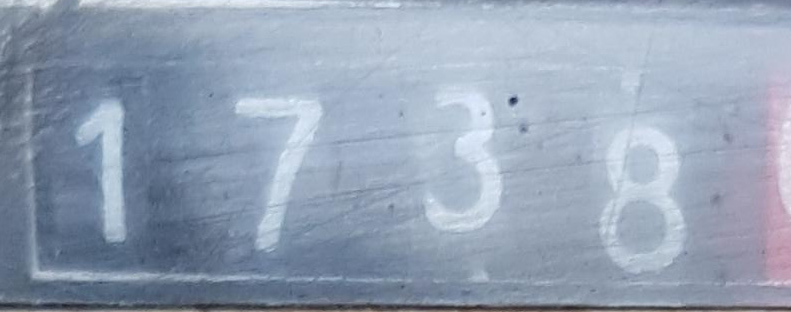

ocr result :  0208


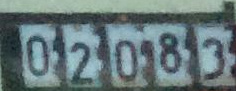

ocr result :  219312


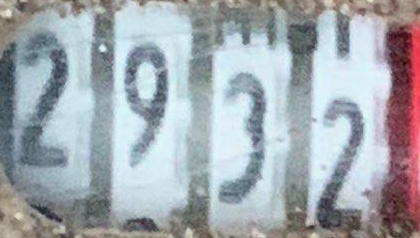

ocr result :  1105


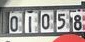

ocr result :  6061


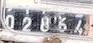

ocr result :  0203


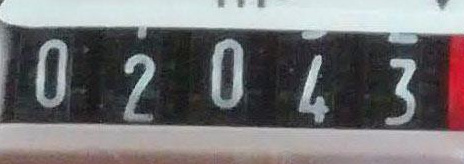

ocr result :  n120


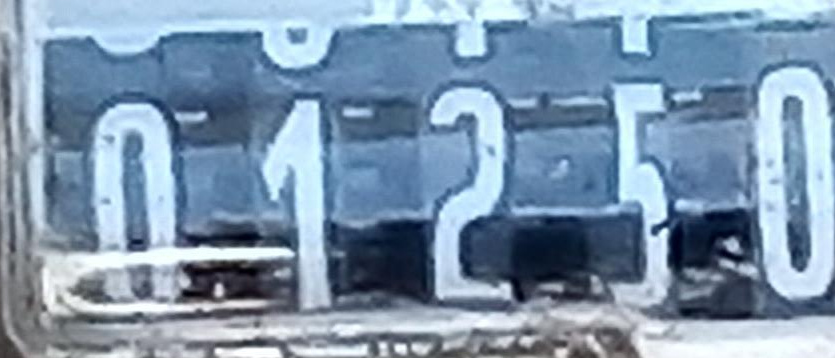

ocr result :  OHE


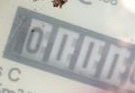

ocr result :  059


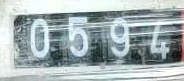

ocr result :  3054


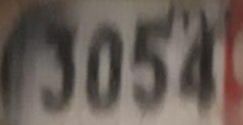

ocr result :  0E


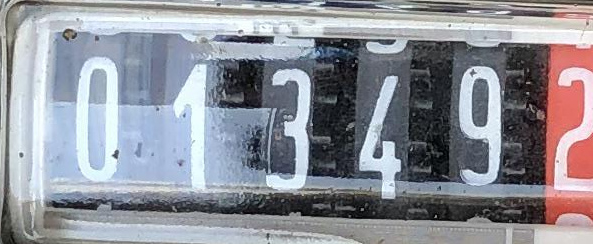

ocr result :  501P


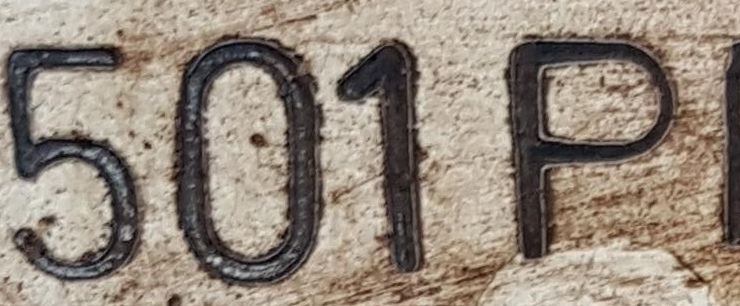

ocr result :  RTOE


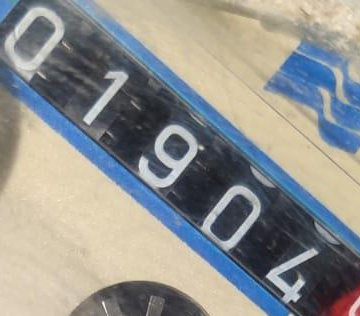

ocr result :  E


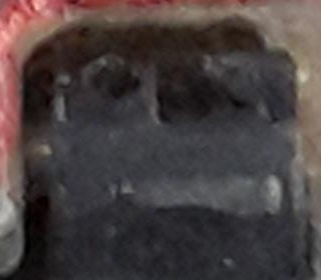

ocr result :  ORT


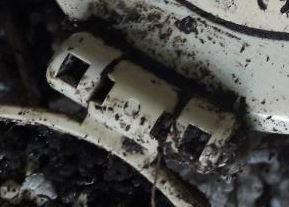

ocr result :  


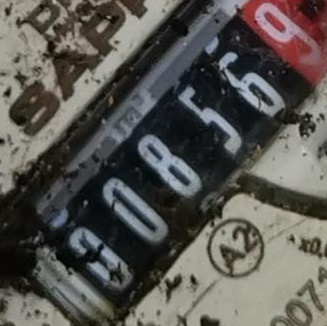

ocr result :  120271


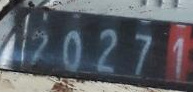

In [51]:
for each in os.listdir(cropped_dir):
  # print(each)
  img = cv2.imread(os.path.join(cropped_dir,each))
  h, w = img.shape[:2]
  if h > w:
    img = cv2.rotate(img.copy(), cv2.cv2.ROTATE_90_CLOCKWISE)
  
  _ = test_img(None, os.path.join(cropped_dir,each) ,None,None,"/content/")
  cv2_imshow(img)

C'est visible que la pérformance d'OCR est fortement liée à l'angle du texte montré.

Toutefois, le résultat n'est pas satisfaisant.

Essayons un 2ème modèle

# 2ème OCR 

# OCRSpace API

Dans le but de connaître les divers types d'outils "prêt à servir" disponibles sur la communauté, l'appel au service OCRSpace se fait par un API.
Essayons avec les images rotationnées. 

In [52]:
import io
import json
import cv2
import numpy as np
import requests

# img_dir= "/content/yolov_v1_detect_test_cropped/content/yolov5/runs_meter/detect_test2/crops/meter/abokgn_jpg.rf.838ab0a80b444fb0b436d02f72bee4f0.jpg"
cropped_dir = "/content/yolov_v1_detect_test_cropped/content/yolov5/runs_meter/detect_test2/crops/meter/"
# # img_dir = "/content/datasets/meter/images/test/abokgn_jpg.rf.838ab0a80b444fb0b436d02f72bee4f0.jpg"

# # test_img(None,img_dir, None, None, "/content/")

for each in os.listdir(cropped_dir):

  img_dir = os.path.join(cropped_dir,each)
  img = cv2.imread(img_dir)
  height, width, _ = img.shape
  if height > width:
    img = cv2.rotate(img.copy(), cv2.cv2.ROTATE_90_CLOCKWISE)

  url_api = "https://api.ocr.space/parse/image"
  _, compressedimage = cv2.imencode(".jpg", img, [1, 90])
  file_bytes = io.BytesIO(compressedimage)

  result = requests.post(url_api,
              files = {img_dir: file_bytes},
              data = {"apikey": "K81338537988957",
                      "language": "eng"})
  result = result.content.decode()
  result = json.loads(result)

  parsed_results = result.get("ParsedResults")[0]
  text_detected = parsed_results.get("ParsedText")

  if text_detected == "":
    print("Nothing recognized")
  else:
    print(text_detected)

00946

Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
Nothing recognized
912027 i



Une recoannaissance intégrale de la prémière image mais rien pour les autres.

Une invéestigation plus approfondie sur le modèle utilisé par OCRSpace se fait nécessaire.

Partons ensuite à une autre librarie: MMCV

# With MMCV

In [53]:
!pip install -q condacolab
import condacolab
condacolab.install()

⏬ Downloading https://github.com/jaimergp/miniforge/releases/latest/download/Mambaforge-colab-Linux-x86_64.sh...
📦 Installing...
📌 Adjusting configuration...
🩹 Patching environment...
⏲ Done in 0:00:28
🔁 Restarting kernel...


In [ ]:
!conda create -n open-mmlab python=3.7 -y
!conda activate open-mmlab

!conda install pytorch==1.6.0 torchvision==0.7.0 cudatoolkit=10.1 -c pytorch

# install the latest mmcv-full
!pip install mmcv-full -f https://download.openmmlab.com/mmcv/dist/cu101/torch1.6.0/index.html

# install mmdetection
!pip install mmdet

# install mmocr
!git clone https://github.com/open-mmlab/mmocr.git
%cd mmocr

!pip install -r requirements.txt
!pip install -v -e .  # or "python setup.py develop"
!export PYTHONPATH=$(pwd):$PYTHONPATH

# for albumentations
!pip install -r requirements/albu.txt

In [ ]:
!python mmocr/utils/ocr.py demo/demo_text_ocr.jpg --print-result --imshow

In [3]:
from mmocr.utils.ocr import MMOCR

# Load models into memory
ocr = MMOCR(det=None, recog='CRNN_TPS')

load checkpoint from http path: https://download.openmmlab.com/mmocr/textrecog/tps/crnn_tps_academic_dataset_20210510-d221a905.pth


Downloading: "https://download.openmmlab.com/mmocr/textrecog/tps/crnn_tps_academic_dataset_20210510-d221a905.pth" to /root/.cache/torch/checkpoints/crnn_tps_academic_dataset_20210510-d221a905.pth


  0%|          | 0.00/38.5M [00:00<?, ?B/s]

In [ ]:
# !pip install opencv-contrib-python
# !pip3 install opencv-contrib-python
!conda install -c conda-forge opencv=2.4

In [5]:
import os
os.mkdir("/content/mmocr_results")

In [15]:
import cv2
from google.colab.patches import cv2_imshow

cropped_dir = "/content/yolov_v1_detect_test_cropped/content/yolov5/runs_meter/detect_test2/crops/meter/"


for each in os.listdir(cropped_dir):
  img_dir = os.path.join(cropped_dir,each)
  img = cv2.imread(img_dir)
  results = ocr.readtext(img,export='/content/mmocr_results/',output='/content/mmocr_results/', print_result=True, cv2_imshow=True)
# results = ocr.readtext(%INPUT_FOLDER_PATH%, output = %OUTPUT_FOLDER_PATH%, batch_mode=True, single_batch_size = 10)

{'text': 'f', 'score': [0.13778269290924072]}

{'text': 'ononaizes', 'score': [0.8392619490623474, 0.4033353924751282, 0.6530752182006836, 0.19510780274868011, 0.19989244639873505, 0.369133859872818, 0.32636362314224243, 0.379459023475647, 0.9411515593528748]}

{'text': 'gocoo', 'score': [0.4323454201221466, 0.9590117335319519, 0.5001044869422913, 0.7430452108383179, 0.5355568528175354]}

{'text': 'ozos', 'score': [0.7080844044685364, 0.6067260503768921, 0.8649267554283142, 0.8719270825386047]}

{'text': 'pe', 'score': [0.1379384845495224, 0.2746819853782654]}

{'text': '02osh', 'score': [0.4849758446216583, 0.2004355937242508, 0.3091576099395752, 0.6443099975585938, 0.2082010805606842]}

{'text': '295ze', 'score': [0.6338932514190674, 0.27864131331443787, 0.1806551218032837, 0.28891846537590027, 0.2754630148410797]}

{'text': 'olioss', 'score': [0.580876350402832, 0.6035876274108887, 0.4727630317211151, 0.7098080515861511, 0.5971365571022034, 0.8358602523803711]}

{'text': 'cobils', '

Nous pouvons observer que ce modèle a une sensibilité beaucoup plus important pour détecter des characters,(il en reconnaît dans toutes les images) néanmoins la reconnaissance soit beaucoup centrée sur des lettres. 

In [ ]:
!zip -r /content/mmocr_results_zipped /content/mmocr_results/